<a href="https://colab.research.google.com/github/santiagoahl/land-cover-segmentation/blob/main/land_cover_segmentation_keras.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<h1 align="center">
  <br>
  U-net and Facebook MaskFormer for satellital object segmentation
  <br>
</h1>

<h4 align="center">Implementation of advanced neural networks for segment the cover of satellital image maps.</h4>

<p align="center">
  <a href='https://keras.io/' target="_blank"><img alt='keras' src='https://img.shields.io/badge/Keras-100000?style=for-the-badge&logo=keras&logoColor=FFFFFF&labelColor=D10000&color=D10000'/></a> <a href='https://www.tensorflow.org/?hl=es-419' target="_blank"><img alt='tensorflow' src='https://img.shields.io/badge/Tensorflow-100000?style=for-the-badge&logo=tensorflow&logoColor=EC8D1E&labelColor=908B8B&color=E45A27'/></a> <a href='https://www.kaggle.com/' target="_blank"><img alt='kaggle' src='https://img.shields.io/badge/Kaggle-100000?style=for-the-badge&logo=kaggle&logoColor=37BAE8&labelColor=BEFDFF&color=37BAE8'/></a>
</p>

>[TO-DO List](#scrollTo=rVz4v5qcLCfg)

>[Libraries & Modules](#scrollTo=Bd6fH_rGwgs4)

>[Data import](#scrollTo=k7-uwN5SwiW4)

>>[In colab Environment](#scrollTo=Pzw2x10nwK88)

>>[In Kaggle environment](#scrollTo=X53xTbjHwOEy)

>[Data-viz](#scrollTo=xzFowXlJwllq)

>[Data preprocessing](#scrollTo=be7p1uhAwnY-)

>>[One Hot Encoding](#scrollTo=o9SUX-nVwLaB)

>>[Image Tiling](#scrollTo=xUu10T1QwNVL)

>>>[Disjoint tiling](#scrollTo=65P5t60CNdIl)

>>>[Overlapped tiling](#scrollTo=ACvT10XCNaOU)

>>>>[Padding](#scrollTo=2cttQTOmJwPv)

>>>>[Cropping](#scrollTo=s7rWQKxbJ09B)

>>[Prepare data to train](#scrollTo=da-f6ze0wH3P)

>[Training](#scrollTo=7dze0c_wwo9h)

>>[U-Net](#scrollTo=BqQ5l3nuNksC)

>>>[IoU (Not finished)](#scrollTo=nYsemT50mVOt)

>>[Mask-Former](#scrollTo=g2MpLSLdNlzT)

>[Testing](#scrollTo=qs1GYHz2xFJv)

>>[CNN](#scrollTo=CtyvBP0UfC-t)

>>[Mask-Former](#scrollTo=q-lXEYiwfC-1)

>[Model export](#scrollTo=ZUSSC83pLCg1)

>[Model import](#scrollTo=kzw1Ll5ixcCA)



# TO-DO List

- [x] Import data
  - [x] Generate a simple import from a `.zip` hosted on Drive.
  - [x] Import data from Kaggle. This link may be useful: [Download Kaggle datasets into Colab](https://towardsdatascience.com/downloading-kaggle-datasets-directly-into-google-colab-c8f0f407d73a).
- [ ] Preprocessing
  - [x] Preprocess data to be read by the model during training.
  - [ ] Customize the previous preprocessing to obtain **normalized** images.
  - [ ] Apply `one-hot encoding` to images.
  - [x] Apply the **Seamless Tiling** strategy to images in a **disjoint** way.
  - [ ] Apply the **Seamless Tiling** strategy to images in an **overlapping** way.
- [ ] Training
  - [ ] Low-level implementations 
    - [ ] Implement stochastic gradient descent using OOP and generate visual demonstrations, ideally compare with the usual gradient.
    - [ ] Implement using OOP different loss functions such as `cross_entropy` and compare them, generate visualizations.
    - [ ] Understand and program using OOP the `.fit()` method of `Keras`.
    - [ ] Track activation functions.
    - [ ] Implement the model using OOP.
  - [ ] U-Net
    - [ ] Read the complete U-Net paper.
    - [x] Generate a first U-Net with `num_filters=16` and image size of `256x256`.
    - [ ] Generate a U-Net training that receives images after applying tiling and one-hot encoding.
    - [ ] Implement the training with all the low-level functions and classes created.
  - [ ] Visual-Transformer
    - [ ] Read the paper on facebook's `maskformer`.
    - [ ] Do transfer learning to bring this model from Hugging Face.
- [ ] Testing
  - [x] Generate standard metrics of each model such as `accuracy_score` and calculate its performance. Also plot learning curves.
  - [ ] Create a custom metric `IoU` or `dice` that can be compiled by `Keras` in the `.fit()` method.
  - [ ] Generate a compact module for a user to enter an image and obtain predictions for that image (With overlap), may need to cut images, generate as many predictions as cuts and paste the masks that were predicted.
- [ ] Reproducibility: Generate a notebook associated with this one on Kaggle for people to run it
- [ ] MLOPs: Generate a way to track models and experiments efficiently to save training results (Graphs, prediction examples, parameters used in each experiment).


# Libraries & Modules

In [ ]:
%%capture
!pip install transformers

In [ ]:
# Data Manipulation
import numpy as np
import pandas as pd

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns

# Computer Vision
import cv2 as cv

# CNN
from tensorflow.keras.models import Sequential
from tensorflow.keras import regularizers
from tensorflow.keras.layers import Conv2D, Dropout, Dense, AveragePooling2D, MaxPooling2D, Flatten, Activation
from tqdm.keras import TqdmCallback

# Vision transformers
from transformers.models.vit.feature_extraction_vit import ViTFeatureExtractor
from transformers import ViTForImageClassification, TrainingArguments, Trainer

# Saving models and data
import joblib

# OS for navigation and environment set up
import os

# Tensorflow
import tensorflow as tf
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Splitting datasets
from sklearn.model_selection import train_test_split

# Random
import random

# Progress bar
from tqdm import tqdm

# Model import 

from keras.models import load_model

# Warnings
import warnings
warnings.filterwarnings('ignore', category=DeprecationWarning)

# Data import

## In colab Environment

Run this cells section only if you're in a colab env. Recall that you must have created the directory `/content/drive/MyDrive/kaggle` and host here your unique kaggle API token `kaggle.json`.

In [ ]:
!pip install kaggle;

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# drive.flush_and_unmount()

In [ ]:
# Check current location, '/content' is the Colab virtual machine
os.getcwd()
# Enable the Kaggle environment, use the path to the directory your Kaggle API JSON is stored in
os.environ['KAGGLE_CONFIG_DIR'] = '/content/drive/MyDrive/kaggle'

In [ ]:
os.chdir('/content')
!kaggle datasets download -d balraj98/deepglobe-land-cover-classification-dataset;

In [ ]:
!unzip '/content/deepglobe-land-cover-classification-dataset.zip';

In [ ]:
class_path = '/content/class_dict.csv'
data_path = '/content/metadata.csv'

df = pd.read_csv(data_path)

train_data_paths = df[df['split']=='train']
test_data_paths = df[df['split']=='test']

In [ ]:
train_data_paths

In [ ]:
labels = pd.read_csv(class_path)
labels

## In Kaggle environment

In [ ]:
base_dir = "/kaggle/input/deepglobe-land-cover-classification-dataset"
train_dir = os.path.join(base_dir, "train")
test_dir = os.path.join(base_dir, "test")
valid_dir = os.path.join(base_dir, "valid")
annotations = pd.read_csv(os.path.join(base_dir, "metadata.csv"))
classes = pd.read_csv(os.path.join(base_dir, "class_dict.csv"))

In [ ]:
class_path = '/kaggle/input/deepglobe-land-cover-classification-dataset/class_dict.csv'
data_path = '/kaggle/input/deepglobe-land-cover-classification-dataset/metadata.csv'

df = annotations

train_data_paths = df[df['split']=='train']
test_data_paths = df[df['split']=='test']

train_data_paths.head()

Now we have to concatenate all the train relative paths with the base dir.

In [ ]:
# Run and Ignore the warnings
train_data_paths['sat_image_path'] = pd.Series([os.path.join(base_dir, path) for path in train_data_paths['sat_image_path']])
train_data_paths['mask_path'] = pd.Series([os.path.join(base_dir, path) for path in train_data_paths['mask_path']])

In [ ]:
train_data_paths

In [ ]:
labels = pd.read_csv(class_path)
labels

,name,r,g,b
0,urban_land,0,255,255
1,agriculture_land,255,255,0
2,rangeland,255,0,255
3,forest_land,0,255,0
4,water,0,0,255
5,barren_land,255,255,255
6,unknown,0,0,0


# Data-viz

In [ ]:
sample_path = train_data_paths['sat_image_path'][3]
sample_image = plt.imread(sample_path)

plt.figure(figsize=(10, 10))
plt.title('Satellital image')
plt.imshow(sample_image)
plt.axis('off')
plt.show()

In [ ]:
sample1 = train_data_paths['sat_image_path'][:200]
sample2 = train_data_paths['mask_path'][:200]

i=-2

fig, ax = plt.subplots(ncols=20, nrows=10, figsize=(20, 10))
for x in range(10):
  i+=1
  for y in range(20):
    i+=1
    if i%2==0:
      path = sample1[5*x+y]
    else:
      path = sample2[5*x+y]
    image = plt.imread(path)
    ax[x, y].imshow(image)
    ax[x, y].axis('off')
plt.suptitle('Satellital images')
fig.show()

Notice that the land segmentation is given by: 

| Class  | Colour |
| --- | --- |
| `urban_land` |  Yellow |
| `agriculture_land` | Cyan |
| `rangeland` | Pink |
| `forest_land` | Green |
| `water` | Blue (or red?) |
| `barren_land` | White |
| `unknown` | Black |


In [ ]:
def plot_overlay(index_img=0, data_path=train_data_paths):
  # Load the image and the mask
  img = plt.imread(data_path['sat_image_path'][index_img])
  mask = plt.imread(data_path['mask_path'][index_img])

  # Create a figure and axes
  fig, axs = plt.subplots(1,3, figsize=(24,8))

  # Display the sat image
  axs[0].imshow(img)
  axs[0].set_title("Sat Image")
  axs[0].axis('off')

  # Display the mask
  axs[1].imshow(mask)
  axs[1].set_title("Mask")
  axs[1].axis('off')

  # Display the mask over the sat image
  axs[2].imshow(img)
  axs[2].imshow(mask, alpha=0.3)
  axs[2].set_title("Overlay")
  axs[2].axis('off')

  # show the plot
  plt.show()

Observe how segmentations are displayed:

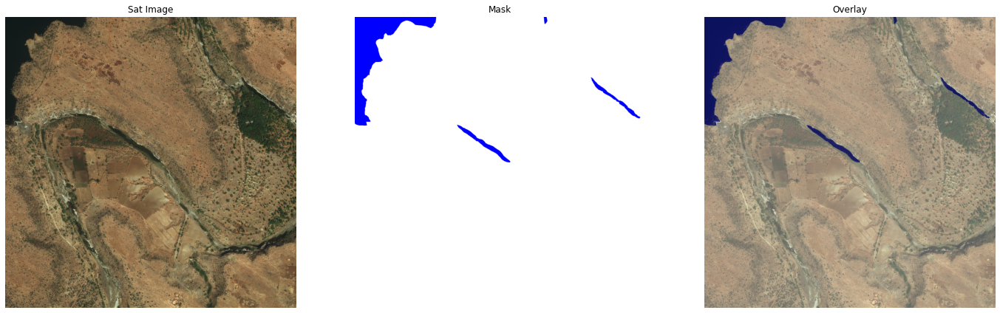

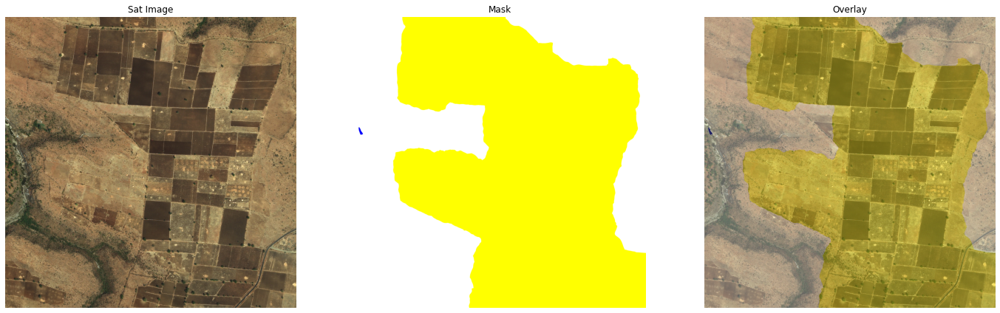

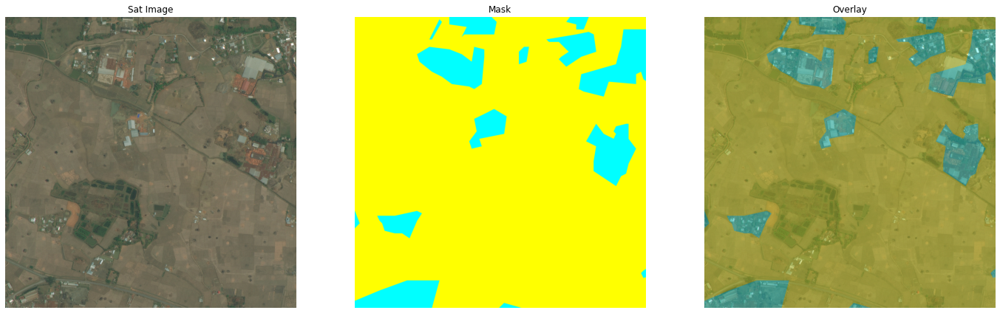

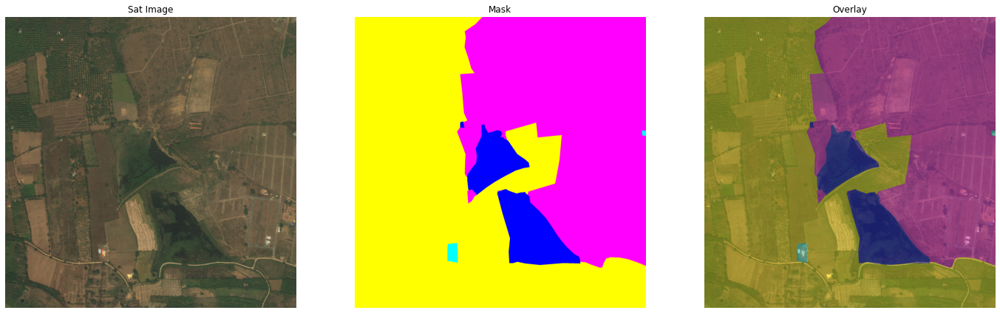

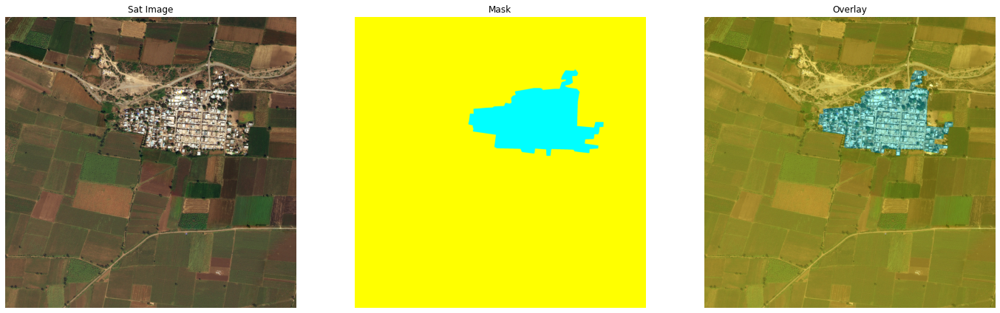

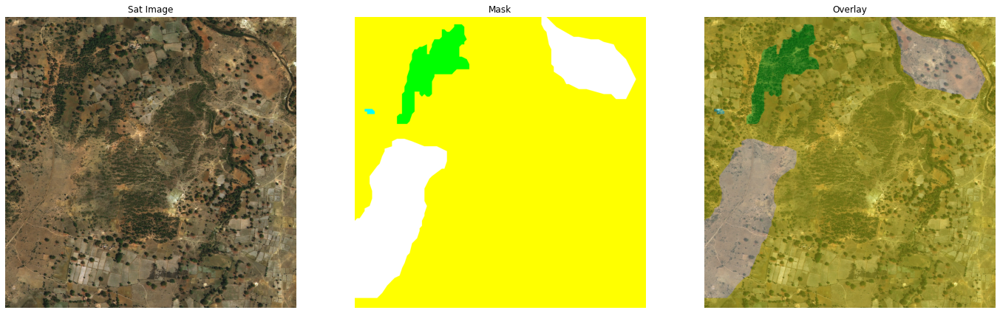

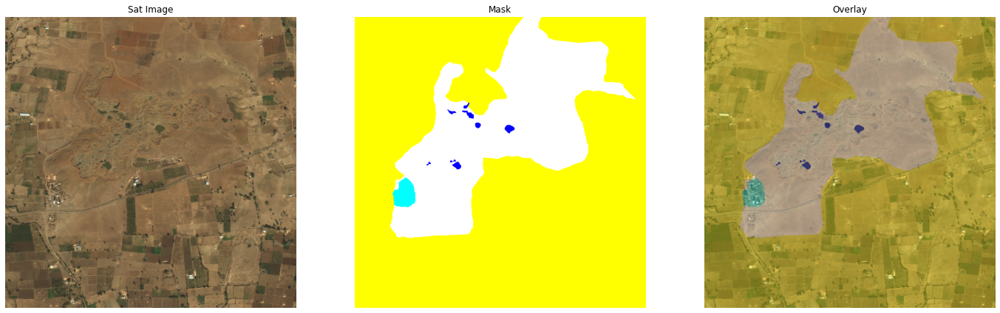

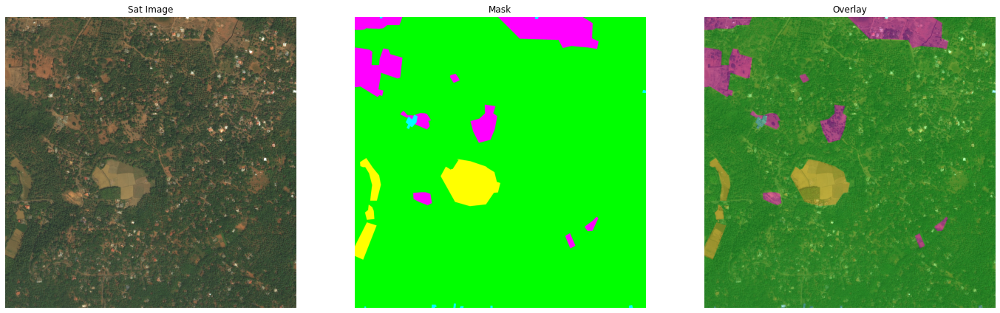

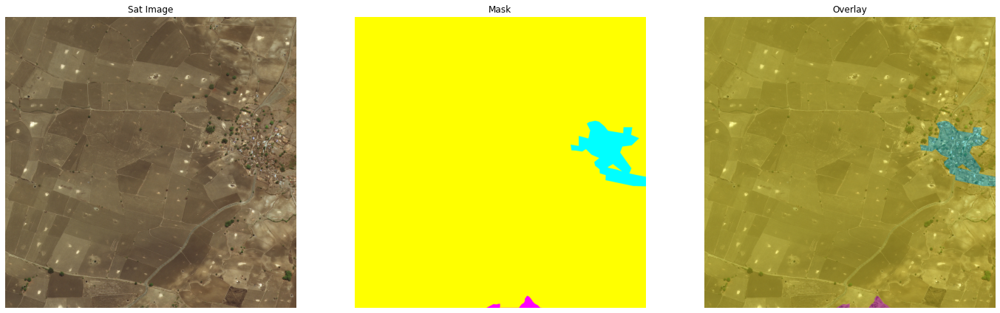

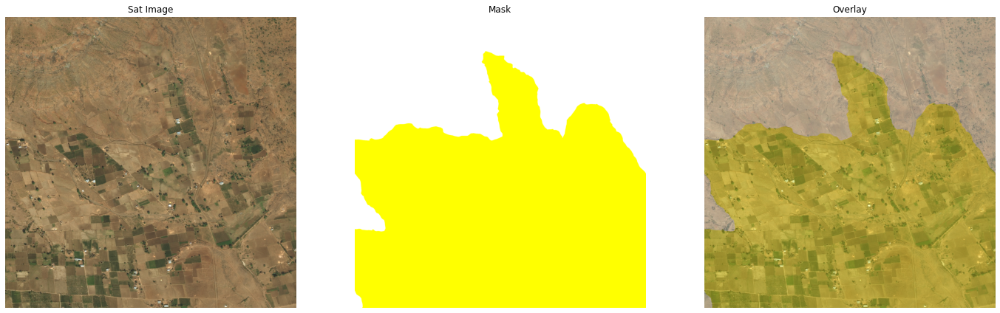

In [ ]:
for i in random.sample(range(len(train_data_paths)), 10):
  plot_overlay(index_img=i)

# Data preprocessing

## One Hot **Encoding**

Target: convert mask rgb values into one hot encoding vectors.

In [ ]:
train_data_paths['mask_path'][8]

'/kaggle/input/deepglobe-land-cover-classification-dataset/train/111335_mask.png'

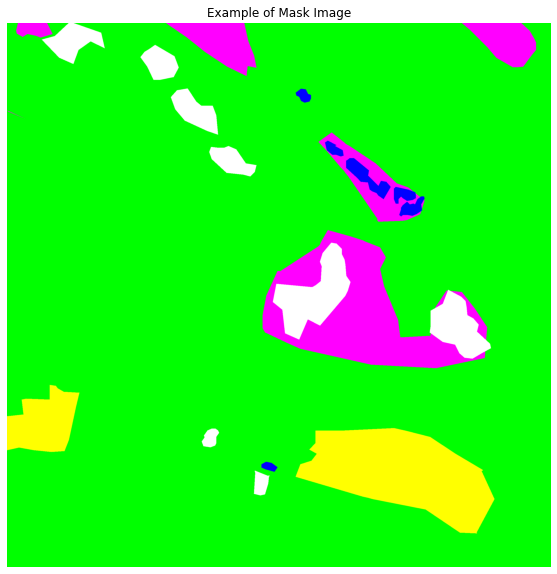

In [ ]:
sample_image = plt.imread(train_data_paths['mask_path'][8])

plt.figure(figsize=(10, 10))
plt.title('Example of Mask Image')
plt.axis('off')
plt.imshow(sample_image)
plt.show()

In [ ]:
sample_image[45][68]

array([1., 0., 1.], dtype=float32)

In [ ]:
uniques = np.array([sample_image[i][j] for i in range(2448) for j in range(2448)])
uniques = np.unique(uniques)

In [ ]:
uniques

array([0., 1.], dtype=float32)

In [ ]:
uniques 

array([0., 1.], dtype=float32)

## Image Tiling

In [ ]:
sample_path = train_data_paths['sat_image_path'][0]
sample_image = plt.imread(sample_path) / 255.0

In [ ]:
sample_image.shape

(2448, 2448, 3)

In [ ]:
plt.figure(figsize=(15, 15))
plt.imshow(sample_image)
plt.title('Sample image before tiling')
plt.axis('off')
plt.show()

### Disjoint tiling

We are going to usea a tile of size $272\times272$ In order to apply a seamless semantic segmentation.

In [ ]:
def crop_image(image, tile_shape=(272, 272), show_results=True) -> np.ndarray:  
  """
  Parameters: 

    - image=np.ndarray. Representation of image as a numpy tensor, must have 3 dimensions.
    - tile_shape= tuple. size of tile dimensions. Its values must be divisors of the ones of the original image according with axes. Each cropped image will have this size
    - show_results=bool. Boolean selection for visualization purposes.
  
  Output: List of cropped images as a Numpy ndarray 
  """

  image_shape = image.shape
  n_rows = image_shape[0] // tile_shape[0]
  n_cols = image_shape[1] // tile_shape[1]

  sub_images = []
  if show_results==True: 
    fig, ax = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(15, 15))

  for i in range(n_rows):
    for j in range(n_cols):
      sub_image = image[i*272:(1+i)*272,j*272:(1+j)*272,:]
      sub_images.append(sub_image)
      if show_results==True:
        ax[i, j].imshow(sub_image)
        ax[i, j].axis('off')

  if show_results==True:
    fig.suptitle('Cropped Images')
    plt.show()

  sub_images = np.array(sub_images)
  return sub_images

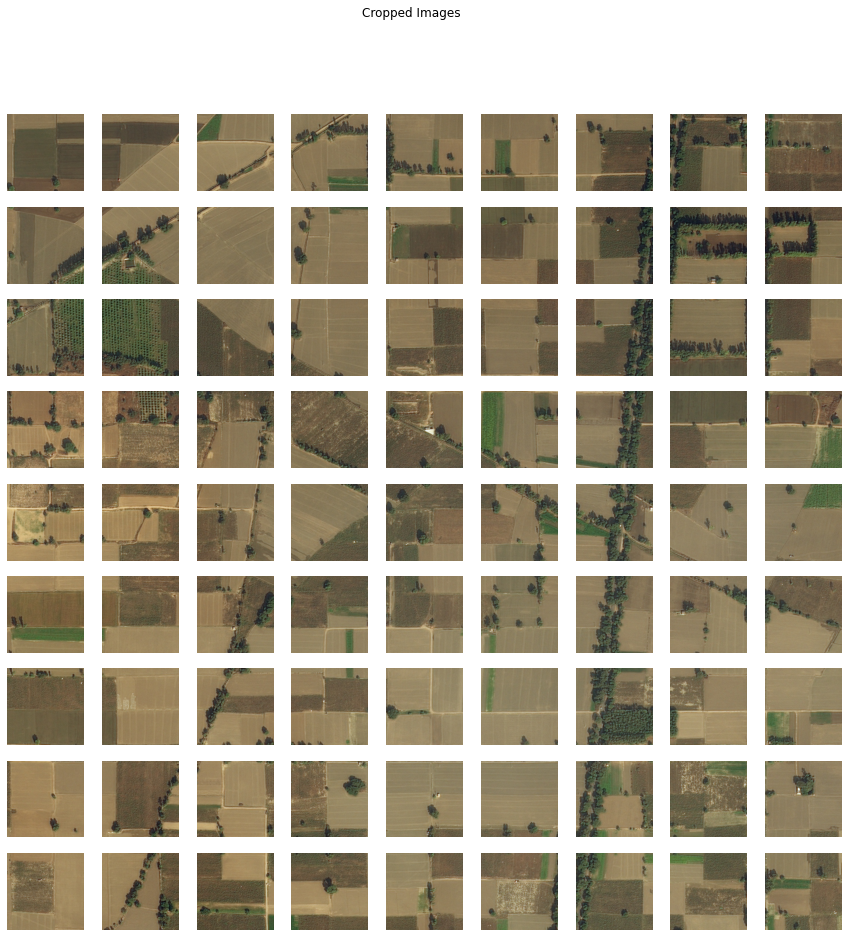

In [ ]:
sub_images = crop_image(sample_image)

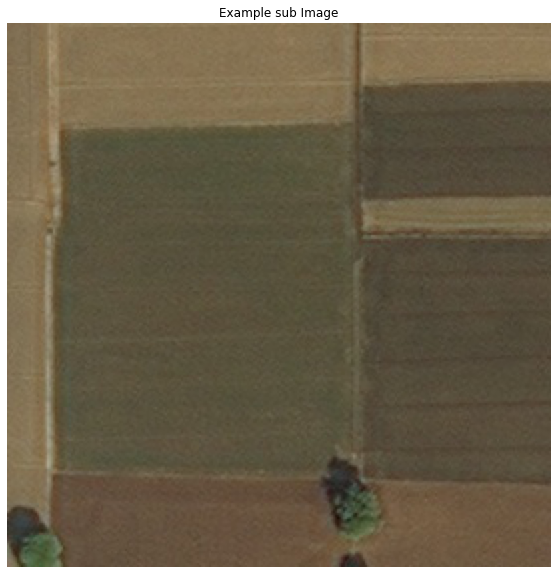

In [ ]:
plt.figure(figsize=(10, 10))
plt.title('Example sub Image')
plt.axis('off')
plt.imshow(sub_images[0])
plt.show()

In [ ]:
def re_crop_image(cropped_images, image_shape=(2448, 2448, 3), show_results=True)->np.ndarray:
  """
  Parameters:
    - cropped_images(np.ndarray): Set of sub images as a numpy tensor or list of numpy 3D arrays.
    - image_shape (tuple). Desired output image shape.
    - show_results (bool). Boolean selection for visualization purposes.

  Output: new_image=np.ndarray. Image cropped as np array.
  """
  new_image = np.zeros((2448, 2448, 3))
  tile_shape = cropped_images[0].shape
  cropped_images = list(cropped_images)
  n_rows = image_shape[0] // tile_shape[0]
  n_cols = image_shape[1] // tile_shape[1]
  width = tile_shape[0]
  high = tile_shape[1]
  half_width = width // 2
  half_high = high // 2
  for i in range(n_rows):
    for j in range(n_cols):
      sub_image = cropped_images[i*n_rows+j]
      new_image[i*high:(1+i)*high,j*width:(1+j)*width,:] = sub_image

  if show_results:
    plt.figure(figsize=(15, 15))
    plt.axis('off')
    plt.title('Re-Cropped Image')
    plt.imshow(new_image)
  return new_image

In [ ]:
sub_images[0][0, 0]

array([0.50588235, 0.42745098, 0.32156863])

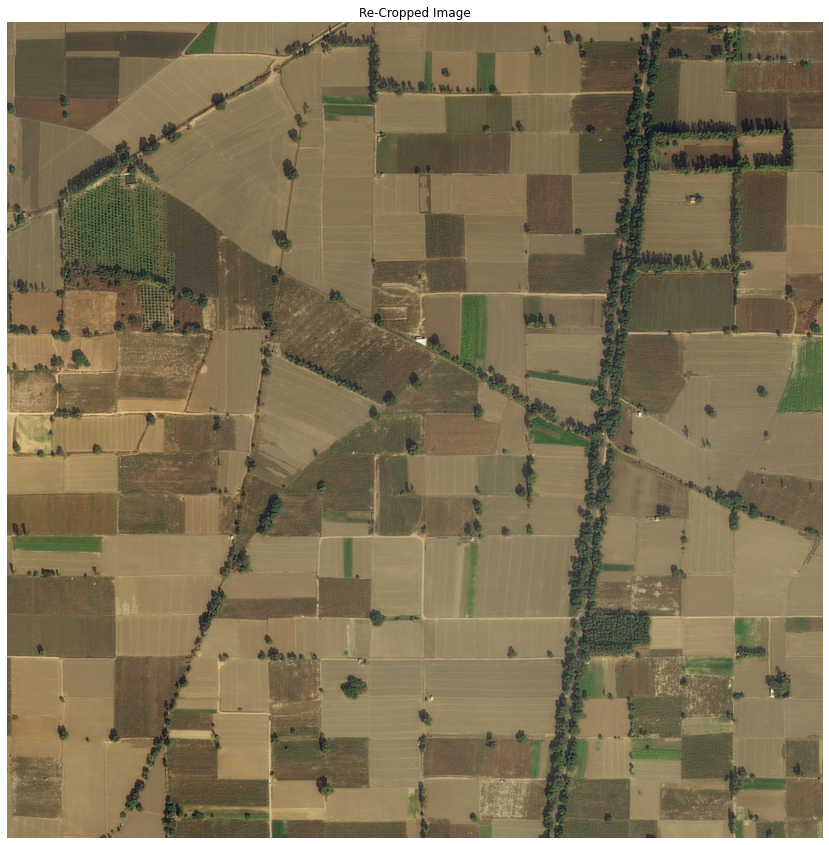

In [ ]:
re_cropped_image = re_crop_image(sub_images)

In [ ]:
sub_images.shape

(81, 272, 272, 3)

### Overlapped tiling

In [ ]:
sample_path = train_data_paths['sat_image_path'][0]
sample_image = plt.imread(sample_path) / 255.0

sample_mask_path = train_data_paths['mask_path'][0]
sample_mask = plt.imread(sample_mask_path)

#### Padding

The function `pad()` takes as an input an image represented as a 3D NumPy array, and pads the image by mirroring and pasting the mirrored image on the borders. The function applies mirroring on the corners and laterals of the original image, the size of the mirrors are determined by the tile_shape parameter, which is by default (306,306). The function then creates a new image and pastes the mirrored corners and laterals on the new image. The final image is returned by the function, which has an extension on each side of the original image.

The function does the following:

1. It calculates the number of rows and columns of the image that can be obtained by dividing the shape of the image by the shape of the tile.

2. It extracts the four corners of the original image, left-up, left-down, right-up and right-down and mirror them.

3. It extracts the laterals of the original image, left, right, up and down and mirror them.

4. It creates a new image which will host the original one and the mirrored crops.
5. It pastes the mirrored corners on the new image.
6. It pastes the mirrored laterals on the new image.
7. It pastes the original image on the center of the new image.
8. It returns the new image.

This function will be useful in our semantic segmentation pipeline, where the goal is to classify each pixel of an image into different categories. To perform the classification, the image is divided into smaller subimages, and a model is trained on these subimages. The function can be used to create a new image that is the same size as the original image, but with mirrored borders. This can be used to reduce the number of zero-padded subimages, and thus improve the accuracy of the classification.

In [ ]:
def pad(image: np.array, tile_shape: tuple=(306, 306)) -> np.array:
  """
  Pads an image by mirroring and pasting the mirrored image on the borders.
    
  Parameters:
      - image (np.array): 3D array representing the image to be padded.
      - tile_shape (Tuple[int, int]): shape of the tile (default: (306, 306))

  Returns:
      - np.array: padded image.
  """
  image_shape = image.shape

  n_rows = image_shape[0] // tile_shape[0]
  n_cols = image_shape[1] // tile_shape[1]

  last_row = 2 * n_rows - 1
  last_col = 2 * n_cols - 1

  width = tile_shape[0]
  high = tile_shape[1]

  half_width = width // 2
  half_high = high // 2

  # Extract laterals and corners of original image, the mirror them

    # Corners
  left_up = image[0:half_width, 0:half_high, :]
  left_down = image[last_row*half_width:(1+last_row)*half_width, 0:half_high, :]
  right_up = image[0:half_width:, last_col*half_high:(1+last_col)*half_high, :]
  right_down = image[last_row*half_width:(1+last_row)*half_width, last_col*half_high:(1+last_col)*half_high, :]

  mirror_left_up = np.flip(np.flip(left_up, axis=0), axis=1)
  mirror_left_down = np.flip(np.flip(left_down, axis=0), axis=1)
  mirror_right_up = np.flip(np.flip(right_up, axis=0), axis=1)
  mirror_right_down = np.flip(np.flip(right_down, axis=0), axis=1)

    # Laterals
  left = image[:, 0:half_high, :]
  right = image[:, last_col*half_high:(1+last_col)*half_high, :]
  up = image[0:half_width, :, :]
  down = image[last_row*half_width:(1+last_row)*half_width, :, :]

  mirror_left = np.flip(left, axis=1)
  mirror_right = np.flip(right, axis=1)
  mirror_up = np.flip(up, axis=0)
  mirror_down = np.flip(down, axis=0)

  # Create a new image which hosts the original one and the mirrored crops

  new_image = np.zeros((image_shape[0]+2*half_high, image_shape[1]+2*half_width, 3))

  # Paste Corners

  new_last_row = n_rows * 2 + 1
  new_last_col = n_cols * 2 + 1

  new_image[0:half_width, 0:half_high, :] = mirror_left_up
  new_image[new_last_row*half_width:(1+new_last_row)*half_width, 0:half_high, :] = mirror_left_down
  new_image[0:half_width:, new_last_col*half_high:(1+new_last_col)*half_high, :] = mirror_right_up
  new_image[new_last_row*half_width:(1+new_last_row)*half_width, new_last_col*half_high:(1+new_last_col)*half_high, :] = mirror_right_down

  # Paste Laterals 

  new_image[half_high:(new_last_row)*half_width, 0:half_width, :] = mirror_left
  new_image[half_high:(new_last_row)*half_width, new_last_col*half_width:(1+new_last_col)*half_width, :] = mirror_right

  new_image[0:half_high, half_width:(new_last_col)*half_high, :] = mirror_up
  new_image[new_last_row*half_width:(1+new_last_row)*half_width, half_width:(new_last_col)*half_high, :] = mirror_down

  # Paste Original Image

  new_image[half_high:(new_last_row)*half_width, half_width:(new_last_col)*half_high,:] = image

  return new_image

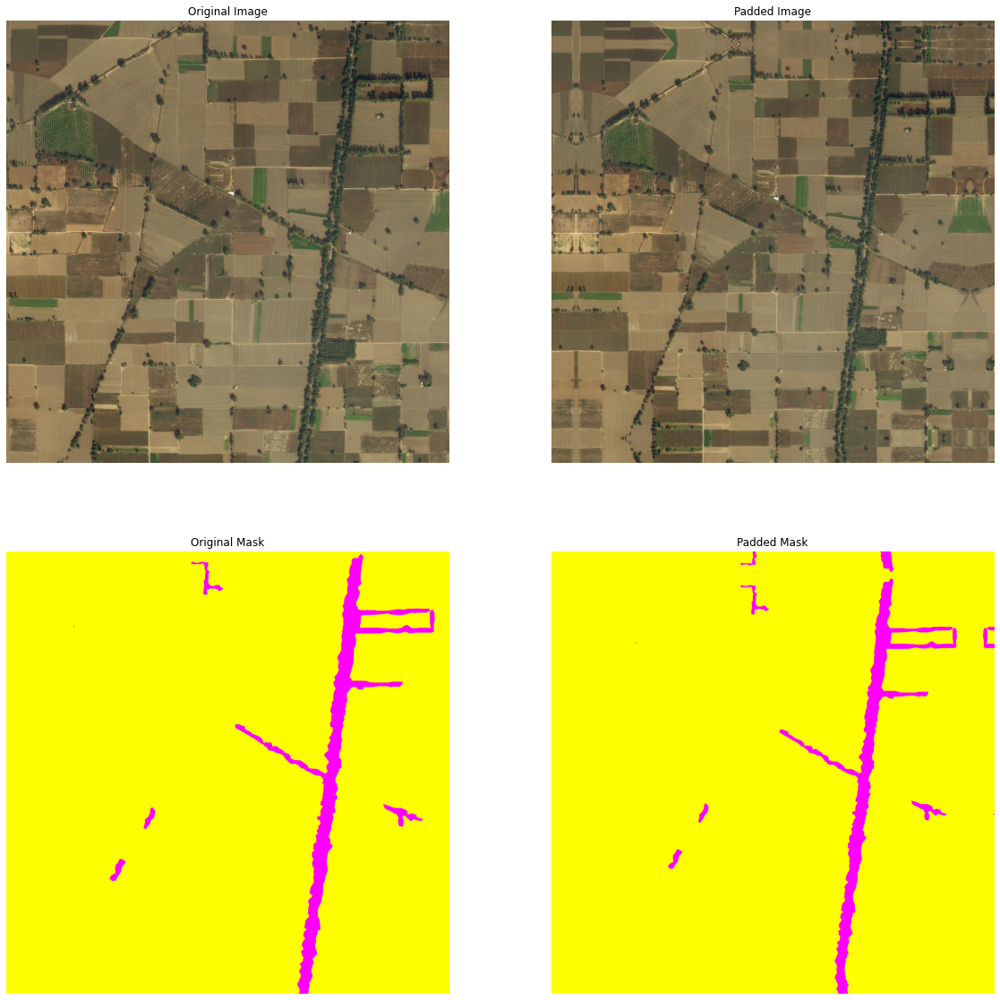

In [ ]:
fig, ax = plt.subplots(2, 2, figsize=(20, 20))

ax[0, 0].imshow(sample_image)
ax[0, 0].set_title('Original Image')
ax[0, 0].axis('off')

ax[0, 1].imshow(pad(sample_image))
ax[0, 1].set_title('Padded Image')
ax[0, 1].axis('off')

ax[1, 0].imshow(sample_mask)
ax[1, 0].set_title('Original Mask')
ax[1, 0].axis('off')

ax[1, 1].imshow(pad(sample_mask))
ax[1, 1].set_title('Padded Mask')
ax[1, 1].axis('off')

plt.show()

#### Cropping

The function `overlap_crop_image` is used to crop an image into smaller sub-images by moving the cropping window by half the size of the tile in both the x and y axis. The cropping window is defined by the tile_shape parameter, which is a tuple of length 2 representing the width and height of the window. The function also accepts a boolean parameter show_results, which when set to true, will display the cropped images in a grid using matplotlib. The function first pads the original image using the pad() function, which add mirrored copies of the outer parts of the image, this is done to avoid boundary issues during cropping. Then, it calculates the number of rows and columns of sub-images that can be obtained from the image and the tile shape. It creates an empty list called sub_images which will store the cropped images. Next, it uses nested loops to move the cropping window over the image, and in each iteration, it crops the image using the current window position and adds the resulting sub-image to the sub_images list. If show_results is true, it also displays each sub-image in a grid using matplotlib. Finally, it converts the sub_images list to a numpy array and returns it.

In [ ]:
def overlap_crop_image(image, tile_shape=(306, 306), show_results=False) -> np.ndarray:  
  """
  Parameters: 

    - image(np.ndarray). Representation of image as a numpy tensor, must have 3 dimensions.
    - tile_shape(tuple). size of tile dimensions. Its values must be divisors of the ones of the original image according with axes. Each cropped image will have this size
    - show_results(bool). Boolean selection for visualization purposes.
  
  Returns: List of cropped images as a Numpy ndarray. Each cropped image has the half of its 4 neighbors i.e. the tile moves each half of its size.
  """
  image = pad(image)
  image_shape = image.shape

  n_rows = 2 * (image_shape[0] // tile_shape[0]) - 1
  n_cols = 2 * (image_shape[1] // tile_shape[1]) - 1

  last_row = 2 * n_rows - 1
  last_col = 2 * n_cols - 1

  width = tile_shape[0]
  high = tile_shape[1]

  half_width = width // 2
  half_high = high // 2

  sub_images = []

  if show_results==True: 
    fig, ax = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(15, 15))

  for i in range(n_rows):
    for j in range(n_cols):
      sub_image = image[i*half_high:(2+i)*half_high,j*half_width:(2+j)*half_width,:]
      sub_images.append(sub_image)
      if show_results==True:
        ax[i, j].imshow(sub_image)
        ax[i, j].axis('off')

  if show_results==True:
    fig.suptitle('Cropped Images')
    plt.show()

  #sub_images = np.array(sub_images)
  return sub_images

In [ ]:
s = overlap_crop_image(sample_image, show_results=True)

## Prepare data to train

In [ ]:
train_image_paths, train_mask_paths, val_image_paths, val_mask_paths = (train_data_paths['sat_image_path'], train_data_paths['mask_path'], test_data_paths['sat_image_path'], test_data_paths['mask_path'])

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(train_image_paths, train_mask_paths, test_size=0.2, random_state=42)

In [ ]:
X_train

In [ ]:
# Reindexing

X_train = pd.Series(X_train.tolist())
X_test = pd.Series(X_test.tolist())

y_train = pd.Series(y_train.tolist())
y_test = pd.Series(y_test.tolist())

In [ ]:
X_train

In [ ]:
plt.imshow(plt.imread(X_train[2]))
plt.title('Example Sat Image')
plt.axis('off')
plt.show()

In [ ]:
def load_data(images_path, masks_path):
  data = {'images': [], 'masks': []}
  progress_bar = tqdm(range(len(images_path)), 
                      desc="Loading Data", 
                      total=len(images_path), 
                      bar_format="{desc}: {percentage:3.0f}%|\033[32m{bar}\033[0m| {n_fmt}/{total_fmt} [{elapsed}<{remaining}]")
  for i in progress_bar:
    #Read images
    img = plt.imread(images_path[i])
    mask = plt.imread(masks_path[i])
    #Tiling 
    tiled_imgs = overlap_crop_image(img)
    tiled_masks = overlap_crop_image(mask)
    #Save images
    data['images'].extend(tiled_imgs)
    data['masks'].extend(tiled_masks)
  #Save sample as a tensor
  data['images'] = np.array(data['images'])
  data['masks'] = np.array(data['masks'])

  return data

In [ ]:
train_data = load_data(images_path=X_train[0:4], masks_path=y_train[0:4])
test_data = load_data(images_path=X_test[0:4], masks_path=y_test[0:4])

# Training

## U-Net

In [ ]:
def create_conv_block(input_tensor, num_filters):
  """
    Helps us to create the convolutional blocks
  """
  # First Conv layer
  x = tf.keras.layers.Conv2D(filters=num_filters, kernel_size=(3, 3), kernel_initializer='he_normal', padding='same')(input_tensor)
  x = tf.keras.layers.BatchNormalization()(x)
  x = tf.keras.layers.Activation('relu')(x)
  # Second Conv layer

  x = tf.keras.layers.Conv2D(filters=num_filters, kernel_size=(3, 3), kernel_initializer='he_normal', padding='same')(x)
  x = tf.keras.layers.BatchNormalization()(x)
  x = tf.keras.layers.Activation('relu')(x)

  return x

In [ ]:
def create_unet(input_shape, num_filters=16, dropout=0.1):
  """
    Creates the U-Net Architecture
  """
  # Encoder
    # First conv block
  c1 = create_conv_block(input_shape, num_filters * 1)
  p1 = tf.keras.layers.MaxPool2D((2, 2))(c1)
  p1 = tf.keras.layers.Dropout(dropout)(p1)
    # Second conv block
  c2 = create_conv_block(p1, num_filters * 2)
  p2 = tf.keras.layers.MaxPool2D((2, 2))(c2)
  p2 = tf.keras.layers.Dropout(dropout)(p2)
    # Third conv block
  c3 = create_conv_block(p2, num_filters * 4)
  p3 = tf.keras.layers.MaxPool2D((2, 2))(c3)
  p3 = tf.keras.layers.Dropout(dropout)(p3)
    # Fourth conv block
  c4 = create_conv_block(p3, num_filters * 8)
  p4 = tf.keras.layers.MaxPool2D((2, 2))(c4)
  p4 = tf.keras.layers.Dropout(dropout)(p4)

  c5 = create_conv_block(p4, num_filters*16)

  # Decoder
    # First block
  u6 = tf.keras.layers.Conv2DTranspose(num_filters*8, (3, 3), strides=(2, 2), padding='same')(c5)
  u6 = tf.keras.layers.concatenate([u6, c4])
  u6 = tf.keras.layers.Dropout(dropout)(u6)
  c6 = create_conv_block(u6, num_filters*8)
    # Second block
  u7 = tf.keras.layers.Conv2DTranspose(num_filters*4, (3, 3), strides=(2, 2), padding='same')(c6)
  u7 = tf.keras.layers.concatenate([u7, c3])
  u7 = tf.keras.layers.Dropout(dropout)(u7)
  c7 = create_conv_block(u7, num_filters*4)
    #Third block
  u8 = tf.keras.layers.Conv2DTranspose(num_filters*2, (3, 3), strides=(2, 2), padding='same')(c7)
  u8 = tf.keras.layers.concatenate([u8, c2])
  u8 = tf.keras.layers.Dropout(dropout)(u8)
  c8 = create_conv_block(u8, num_filters*2) 
    # Fourth block
  u9 = tf.keras.layers.Conv2DTranspose(num_filters*1, (3, 3), strides=(2, 2), padding='same')(c8)
  u9 = tf.keras.layers.concatenate([u9, c1])
  c9 = tf.keras.layers.Dropout(dropout)(u9)

  output = tf.keras.layers.Conv2D(3, (1, 1), activation='sigmoid')(c9)
  model = tf.keras.Model(inputs = [input_shape], outputs=[output])
  
  return model

In [ ]:
input_shape = train_data['masks'][0].shape;
inputs = tf.keras.layers.Input(input_shape);

model = create_unet(inputs, num_filters=32);

In [ ]:
print(inputs)

KerasTensor(type_spec=TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name='input_2'), name='input_2', description="created by layer 'input_2'")


In [ ]:
early = EarlyStopping(patience=20)
print(input_shape)

(256, 256, 3)


In [ ]:
model.compile(optimizer='Adam', loss='binary_crossentropy', metrics=['accuracy'])

In [ ]:
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d_17 (Conv2D)              (None, 256, 256, 32) 896         input_2[0][0]                    
__________________________________________________________________________________________________
batch_normalization_16 (BatchNo (None, 256, 256, 32) 128         conv2d_17[0][0]                  
__________________________________________________________________________________________________
activation_16 (Activation)      (None, 256, 256, 32) 0           batch_normalization_16[0][0]     
____________________________________________________________________________________________

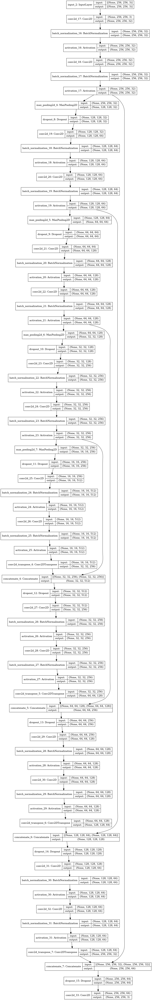

In [ ]:
tf.keras.utils.plot_model(model, show_shapes=True)

In [ ]:
checkpoint = tf.keras.callbacks.ModelCheckpoint('best.hdf5', monitor='accuracy', save_best_only=True, verbose=0)

In [ ]:
model_history = model.fit(train_data['images'], train_data['masks'],
                          epochs=200,
                          verbose=0,
                          batch_size=32,
                          callbacks=[checkpoint, TqdmCallback(verbose=1), early]
                        )

0epoch [00:00, ?epoch/s]

0batch [00:00, ?batch/s]

2023-01-16 23:29:42.048448: W tensorflow/core/framework/cpu_allocator_impl.cc:80] Allocation of 126222336 exceeds 10% of free system memory.
2023-01-16 23:29:42.193389: W tensorflow/core/framework/cpu_allocator_impl.cc:80] Allocation of 504889344 exceeds 10% of free system memory.
2023-01-16 23:29:42.837359: W tensorflow/core/framework/cpu_allocator_impl.cc:80] Allocation of 126222336 exceeds 10% of free system memory.
2023-01-16 23:29:42.939211: W tensorflow/core/framework/cpu_allocator_impl.cc:80] Allocation of 504889344 exceeds 10% of free system memory.
2023-01-16 23:29:43.398468: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)
2023-01-16 23:29:47.773706: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8005


### IoU (Not finished)

In [ ]:
import tensorflow as tf

def iou(y_true, y_pred, smooth=1):
  intersection = tf.reduce_sum(y_true * y_pred, axis=[1,2,3])
  union = tf.reduce_sum(y_true, axis=[1,2,3]) + tf.reduce_sum(y_pred, axis=[1,2,3]) - intersection
  return tf.reduce_mean((intersection + smooth) / (union + smooth))

# Compile the model with the custom IoU metric


In [ ]:
from tensorflow.keras.callbacks import EarlyStopping

In [ ]:
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=[iou])

In [ ]:
model_history = model.fit(X_train, y_train, validation_data=(X_test, y_test),
                          epochs=200,
                          verbose=0,
                          batch_size=6,
                          callbacks=[checkpoint, early, TqdmCallback(verbose=1)]
                      )

## Mask-Former

In [ ]:
!pip install transformers

In [ ]:
from transformers import AutoModel, AutoTokenizer

In [ ]:
model = AutoModel.from_pretrained("facebook/maskformer-swin-large-ade")

# Testing

## CNN

In [ ]:
model_history = model_history.history

In [ ]:
def plot_history(model_history, iteration_message):  
  plt.figure(figsize=(10, 10))

  plt.plot(model_history['loss'], label='Training loss')
  plt.plot(model_history['accuracy'], label='Training accuracy')

  plt.title('U-Net Performance ('+iteration_message+')')
  plt.grid(True)
  plt.savefig('32_filters_256x256_shape.png')#'/content/drive/MyDrive/personal-projects/land-cover-segmentation/images/'+str(iteration_message)+'.png')
  plt.show()

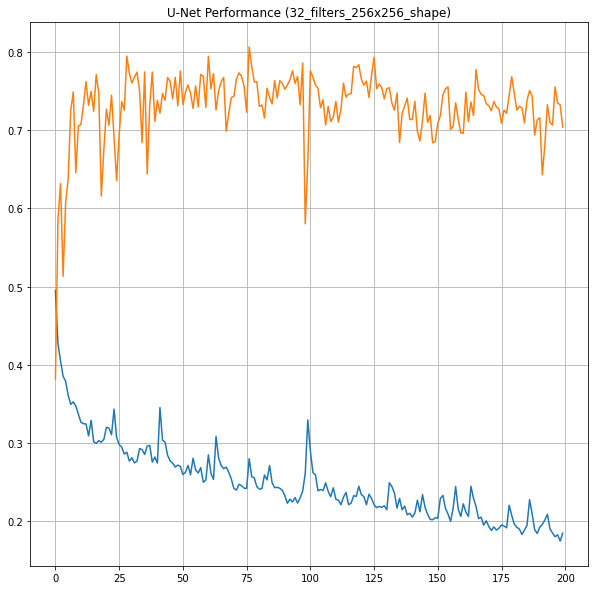

In [ ]:
plot_history(model_history, '32_filters_256x256_shape')

In [ ]:
type(test_data['images'])

numpy.ndarray

In [ ]:
def predict_test_samples(val_map, model):
  imgs = val_map['images']
  masks = val_map['masks']

  predicted_masks = model.predict(imgs)

  return imgs, predicted_masks, masks

In [ ]:
def plot_predictions(image, mask_pred, ground_truth_mask):
  fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(30, 10))

  ax[0].imshow(image)
  ax[0].set_title('Original satellital image')
  ax[0].axis('off')

  ax[1].imshow(mask_pred)
  ax[1].set_title('Predicted Mask')
  ax[1].axis('off')

  ax[2].imshow(ground_truth_mask)
  ax[2].set_title('Ground truth Mask')
  ax[2].axis('off')

  plt.show()

In [ ]:
imgs, predicted_masks, masks = predict_test_samples(test_data, model);

2023-01-17 00:14:46.897123: W tensorflow/core/framework/cpu_allocator_impl.cc:80] Allocation of 126615552 exceeds 10% of free system memory.


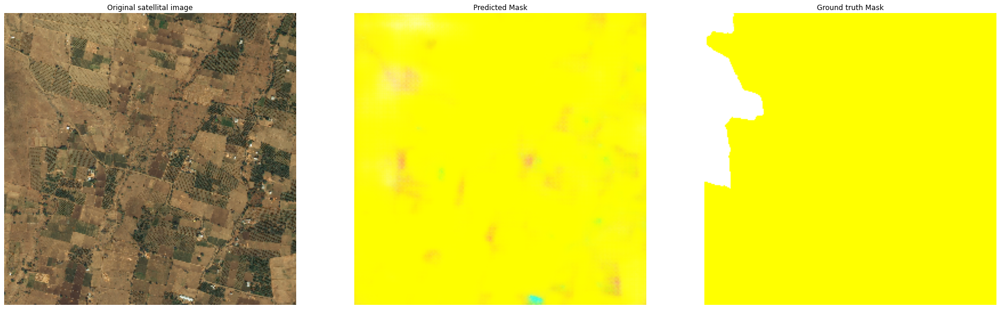

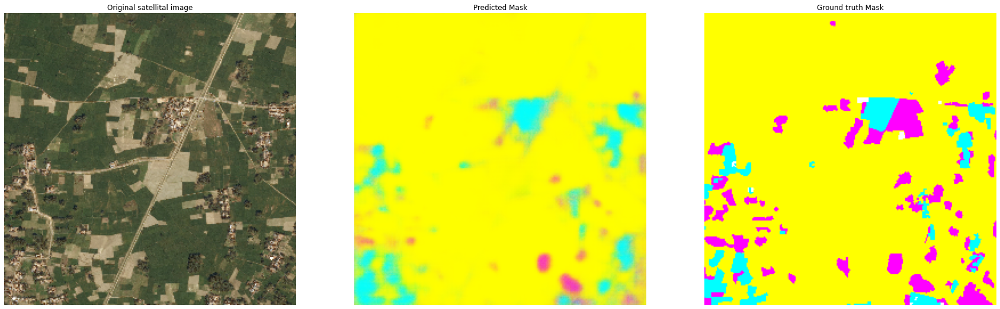

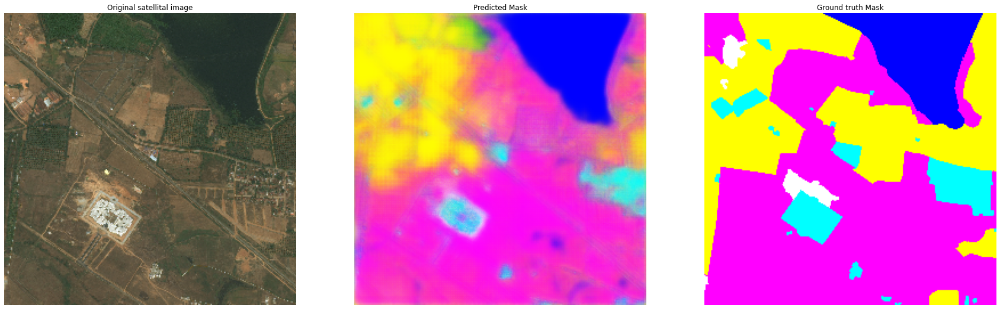

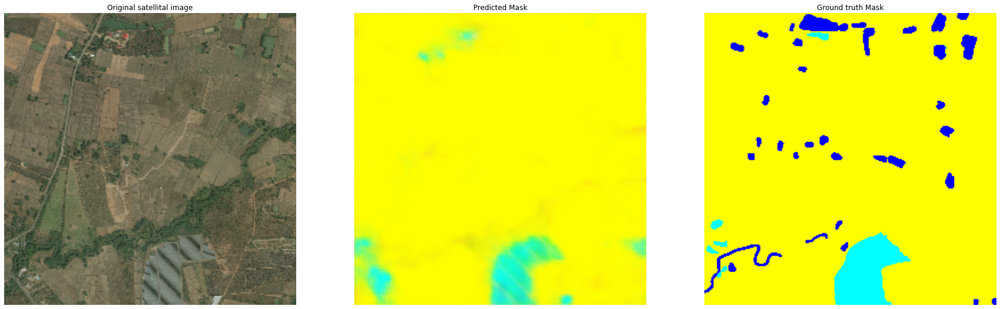

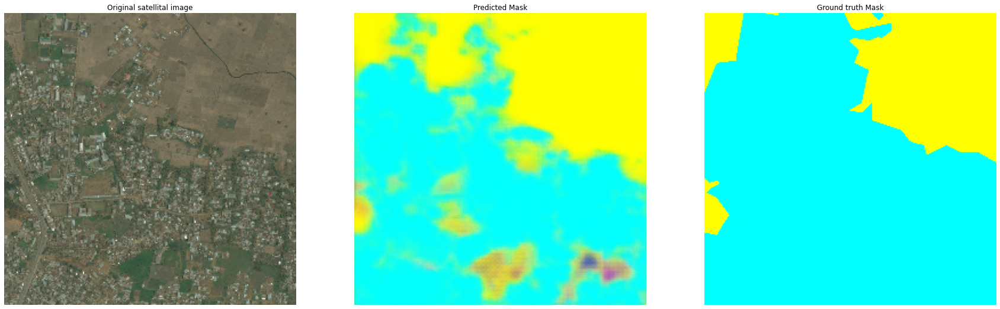

...

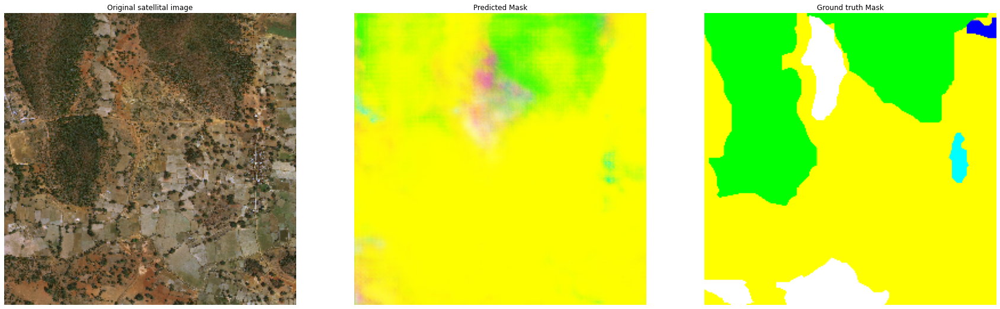

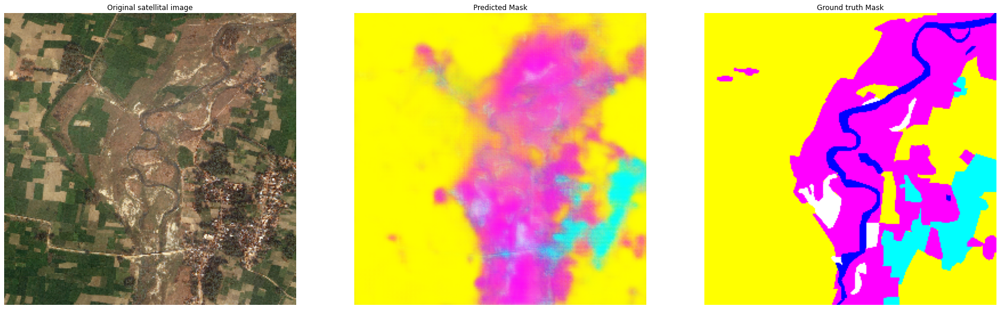

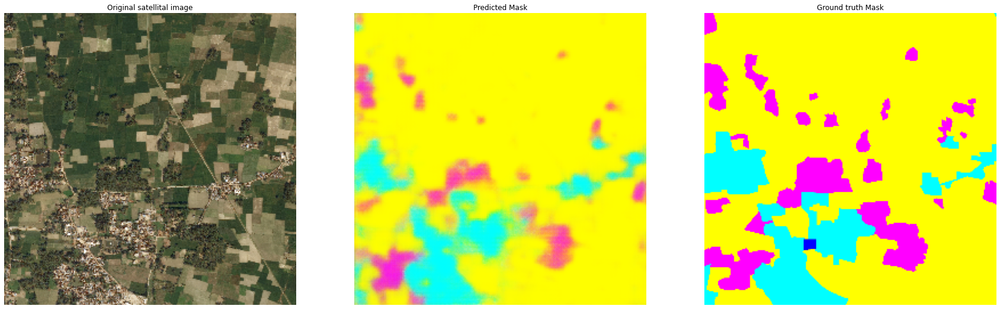

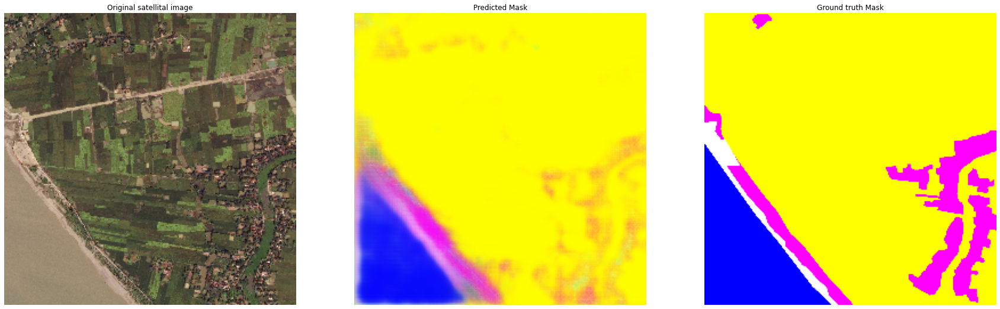

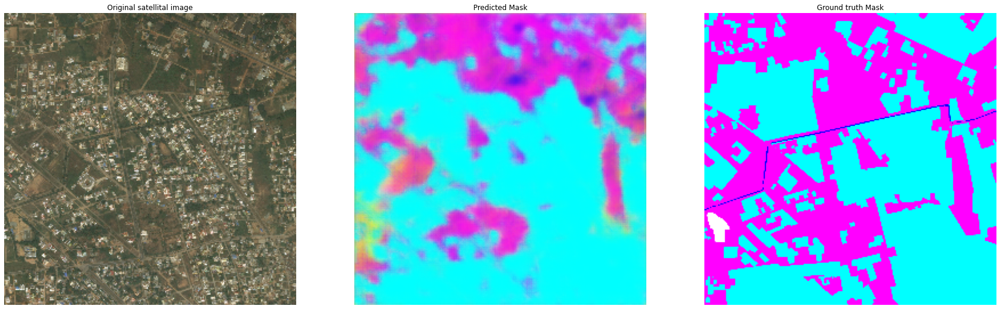

In [ ]:
for i in range(30):
  plot_predictions(imgs[i], predicted_masks[i], masks[i])

## Mask-Former

# Model export

In [ ]:
#In kaggle 

model.save('model.hdf5')

In [ ]:
# In drive

joblib.dump('/content/best.hdf5', '/content/drive/MyDrive/personal-projects/land-cover-segmentation/models/best.hdf5')

# Model import

In [ ]:
# From drive

model2 = joblib.load('/content/drive/MyDrive/personal-projects/land-cover-segmentation/models/best.hdf5')

In [ ]:
# From kaggle

loaded_model = load_model('/kaggle/input/landcover-segmentation-model/model.hdf5')

---
*Let’s change the world, Together!*


<img align=centerright src="https://www.notion.so/image/https%3A%2F%2Fs3-us-west-2.amazonaws.com%2Fsecure.notion-static.com%2F202df933-5432-47f6-aba6-a9a054cece4b%2Fpages-PhotoRoom.png?table=block&id=0b1ffffe-7be4-41f2-86dd-26cad410a64b&spaceId=12eea25e-0790-4a8f-aa1c-b60f93c02da2&width=250&userId=4be5c684-7292-494e-bbb2-2554f1af3879&cache=v2"  width="70" height="70">

<img align=centerright src="https://cdn-icons-png.flaticon.com/512/25/25231.png"  width="70" height="70">
<img align=centerright src="https://cdn-icons-png.flaticon.com/512/61/61109.png?w=360"  width="70" height="70">
<img align=centerright src="https://cdn-icons-png.flaticon.com/512/39/39552.png"  width="70" height="70">
<img align=centerright src="https://cdn.freebiesupply.com/images/large/2x/instagram-icon-white-on-black.png"  width="100" height="70">

[Personal Blog](https://santiagoal.super.site/)      [GitHub](https://github.com/santiagoahl)    [LinkedIn](https://www.linkedin.com/in/santiago-ahumada-lozano/)   [Twitter](https://twitter.com/sahumadaloz)  [Instagram](https://www.instagram.com/santiago_al10/)
